# MSBA305 Project : 
# Brazilian E-Commerce Public Dataset by Olist

## Nour Abdl Ghani- Saja Tawil- Moustapha Ghandour- Lana Harajli

# Dataset Overview: Table Descriptions

| Table Name                | Description                                                               |
|--------------------------|----------------------------------------------------------------------------|
| `customers_df`           | Customer IDs, their unique IDs, zip code prefix, city, and state.          |
| `geolocation_df`         | Zip code prefix with latitude, longitude, city, and state.                 |
| `orders_df`              | Orders made by customers with timestamps for various stages of the order.  |
| `order_items_df`         | Products included in each order (product ID, seller ID, price, freight).   |
| `payments_df`            | Payment details for each order (type, value, installments).                |
| `reviews_df`             | Customer reviews including score, title, message, and timestamps.          |
| `products_df`            | Product information (category, dimensions, weight, photos, etc.).          |
| `sellers_df`             | Seller details such as seller ID and location (zip code, city, state).     |
| `category_translation_df`| Mapping of product categories from Portuguese to English.                  |


# Load the Data

In [2]:
%pip install pymysql sqlalchemy

In [2]:
import pandas as pd
import os
import pandas as pd
from sqlalchemy import create_engine, text
import sqlalchemy

In [200]:
dir_path=r'C:\\Users\\User\\Desktop\\MSBA305- Final Project'

files=[os.path.join(dir_path, file1) for file1 in os.listdir(dir_path)]
print(files)

db_names=['customers_df','geolocation_df','orders_df','order_items_df','payments_df','reviews_df','products_df','sellers_df','category_translation_df']
databases={

}
i=0
for file in files:
    if '.csv' in file:
        data=pd.read_csv(file)
        databases[db_names[i]]=data
        i+=1
        print(data.info())
        print(data.head())

# MySQL connection string 
username = 'root'
password = 'sajatawil123'
host = 'localhost'
port = '3307'
database = 'olist_db'

engine = create_engine(f'mysql+pymysql://{username}:{password}@{host}:{port}/{database}')

with engine.connect() as conn:
    conn.execute(text("SET FOREIGN_KEY_CHECKS=0;"))

    # Customer Table
    databases['customers_df'].to_sql('customers', con=engine, if_exists='replace', index=False,
                        dtype={
                            'customer_id':        sqlalchemy.types.VARCHAR(50),
                            'customer_unique_id': sqlalchemy.types.VARCHAR(50),
                            'customer_zip_code_prefix': sqlalchemy.types.INTEGER(),
                            'customer_city':      sqlalchemy.types.VARCHAR(100),
                            'customer_state':     sqlalchemy.types.VARCHAR(2)
                        })

    # Geolocation Table
    databases['geolocation_df'].to_sql('geolocation', con=engine, if_exists='replace', index=False,
                          dtype={
                              'geolocation_zip_code_prefix': sqlalchemy.types.INTEGER(),
                              'geolocation_lat': sqlalchemy.types.FLOAT(),
                              'geolocation_lng': sqlalchemy.types.FLOAT(),
                              'geolocation_city': sqlalchemy.types.VARCHAR(100),
                              'geolocation_state': sqlalchemy.types.VARCHAR(2)
                          })

    # Orders Table
    databases['orders_df'].to_sql('orders', con=engine, if_exists='replace', index=False,
                     dtype={
                         'order_id': sqlalchemy.types.VARCHAR(50),
                         'customer_id': sqlalchemy.types.VARCHAR(50),
                         'order_status': sqlalchemy.types.VARCHAR(20),
                         'order_purchase_timestamp': sqlalchemy.types.DATETIME(),
                         'order_approved_at': sqlalchemy.types.DATETIME(),
                         'order_delivered_carrier_date': sqlalchemy.types.DATETIME(),
                         'order_delivered_customer_date': sqlalchemy.types.DATETIME(),
                         'order_estimated_delivery_date': sqlalchemy.types.DATETIME()
                     })

    # Order Items Table
    databases['order_items_df'].to_sql('order_items', con=engine, if_exists='replace', index=False,
                          dtype={
                              'order_id': sqlalchemy.types.VARCHAR(50),
                              'order_item_id': sqlalchemy.types.INTEGER(),
                              'product_id': sqlalchemy.types.VARCHAR(50),
                              'seller_id': sqlalchemy.types.VARCHAR(50),
                              'shipping_limit_date': sqlalchemy.types.DATETIME(),
                              'price': sqlalchemy.types.FLOAT(),
                              'freight_value': sqlalchemy.types.FLOAT()
                          })

    # Payments Table
    databases['payments_df'].to_sql('payments', con=engine, if_exists='replace', index=False,
                       dtype={
                           'order_id': sqlalchemy.types.VARCHAR(50),
                           'payment_sequential': sqlalchemy.types.INTEGER(),
                           'payment_type': sqlalchemy.types.VARCHAR(20),
                           'payment_installments': sqlalchemy.types.INTEGER(),
                           'payment_value': sqlalchemy.types.FLOAT()
                       })

    # Reviews Table
    databases['reviews_df'].to_sql('reviews', con=engine, if_exists='replace', index=False,
                      dtype={
                          'review_id': sqlalchemy.types.VARCHAR(50),
                          'order_id': sqlalchemy.types.VARCHAR(50),
                          'review_score': sqlalchemy.types.INTEGER(),
                          'review_comment_title': sqlalchemy.types.TEXT(),
                          'review_comment_message': sqlalchemy.types.TEXT(),
                          'review_creation_date': sqlalchemy.types.DATETIME(),
                          'review_answer_timestamp': sqlalchemy.types.DATETIME()
                      })

    # Products Table
    databases['products_df'].to_sql('products', con=engine, if_exists='replace', index=False,
                       dtype={
                           'product_id': sqlalchemy.types.VARCHAR(50),
                           'product_category_name': sqlalchemy.types.VARCHAR(100),
                           'product_name_lenght': sqlalchemy.types.FLOAT(),
                           'product_description_lenght': sqlalchemy.types.FLOAT(),
                           'product_photos_qty': sqlalchemy.types.FLOAT(),
                           'product_weight_g': sqlalchemy.types.FLOAT(),
                           'product_length_cm': sqlalchemy.types.FLOAT(),
                           'product_height_cm': sqlalchemy.types.FLOAT(),
                           'product_width_cm': sqlalchemy.types.FLOAT()
                       })

    # Sellers Table
    databases['sellers_df'].to_sql('sellers', con=engine, if_exists='replace', index=False,
                      dtype={
                          'seller_id': sqlalchemy.types.VARCHAR(50),
                          'seller_zip_code_prefix': sqlalchemy.types.INTEGER(),
                          'seller_city': sqlalchemy.types.VARCHAR(100),
                          'seller_state': sqlalchemy.types.VARCHAR(2)
                      })

    # Category Translation Table
    databases['category_translation_df'].to_sql('category_translation', con=engine, if_exists='replace', index=False,
                                   dtype={
                                       'product_category_name': sqlalchemy.types.VARCHAR(100),
                                       'product_category_name_english': sqlalchemy.types.VARCHAR(100)
                                   })

    conn.execute(text("SET FOREIGN_KEY_CHECKS=1;"))

print("✅ All tables created and data inserted successfully.")

['C:\\\\Users\\\\User\\\\Desktop\\\\MSBA305- Final Project\\Brazilian E-Commerce Public Dataset by Olist.zip', 'C:\\\\Users\\\\User\\\\Desktop\\\\MSBA305- Final Project\\olist_customers_dataset.csv', 'C:\\\\Users\\\\User\\\\Desktop\\\\MSBA305- Final Project\\olist_geolocation_dataset.csv', 'C:\\\\Users\\\\User\\\\Desktop\\\\MSBA305- Final Project\\olist_orders_dataset.csv', 'C:\\\\Users\\\\User\\\\Desktop\\\\MSBA305- Final Project\\olist_order_items_dataset.csv', 'C:\\\\Users\\\\User\\\\Desktop\\\\MSBA305- Final Project\\olist_order_payments_dataset.csv', 'C:\\\\Users\\\\User\\\\Desktop\\\\MSBA305- Final Project\\olist_order_reviews_dataset.csv', 'C:\\\\Users\\\\User\\\\Desktop\\\\MSBA305- Final Project\\olist_products_dataset.csv', 'C:\\\\Users\\\\User\\\\Desktop\\\\MSBA305- Final Project\\olist_sellers_dataset.csv', 'C:\\\\Users\\\\User\\\\Desktop\\\\MSBA305- Final Project\\product_category_name_translation.csv', 'C:\\\\Users\\\\User\\\\Desktop\\\\MSBA305- Final Project\\querying.py'

# Exploratory Data Analysis (EDA):

In [216]:
# Function to display basic info and summary statistics for each table (only for relevant columns)
def explore_data(databases):
    for table_name, df in databases.items():
        print(f"Exploring {table_name}...\n")
        
        # Data Info (Data types, Non-null counts)
        print("Data Info:")
        print(df.info())
        print("\n")
        
        # Filter numerical columns that are interpretable for summary statistics
        numerical_cols = df.select_dtypes(include=['number']).columns
        
        # Exclude non-relevant columns (e.g., zip codes, geolocation, etc.)
        irrelevant_cols = [
            'customer_zip_code_prefix', 'geolocation_zip_code_prefix', 
            'seller_zip_code_prefix', 'product_name_lenght', 
            'product_description_lenght', 'product_photos_qty', 
            'product_weight_g', 'product_length_cm', 'product_height_cm', 'product_width_cm' ,
            'geolocation_lat', 'geolocation_lng',
        ]
        
        # Keep only relevant numerical columns
        relevant_numerical_cols = [col for col in numerical_cols if col not in irrelevant_cols]
        
        # Summary Statistics (for numerical columns)
        print("Summary Statistics (Relevant Numerical Columns):")
        if len(relevant_numerical_cols) > 0:
            print(df[relevant_numerical_cols].describe())
        else:
            print("No relevant numerical columns for summary statistics.")
        print("\n")

# Explore the data with only interpretable columns
explore_data(databases)

Exploring customers_df...

Data Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99441 entries, 0 to 99440
Data columns (total 5 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   customer_id               99441 non-null  object
 1   customer_unique_id        99441 non-null  object
 2   customer_zip_code_prefix  99441 non-null  int64 
 3   customer_city             99441 non-null  object
 4   customer_state            99441 non-null  object
dtypes: int64(1), object(4)
memory usage: 3.8+ MB
None


Summary Statistics (Relevant Numerical Columns):
No relevant numerical columns for summary statistics.


Exploring geolocation_df...

Data Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000163 entries, 0 to 1000162
Data columns (total 5 columns):
 #   Column                       Non-Null Count    Dtype  
---  ------                       --------------    -----  
 0   geolocation_zip_code_prefix  1000163 

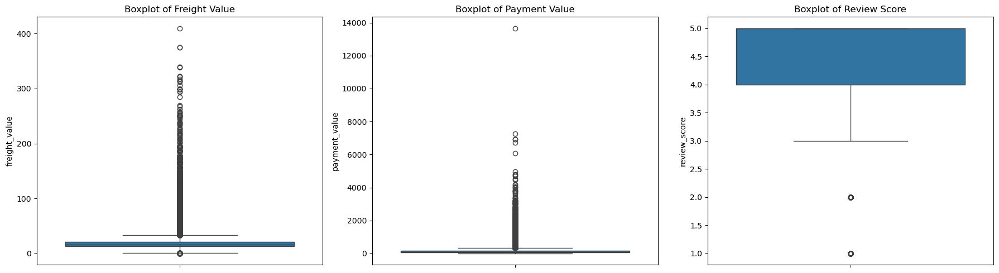

In [234]:
fig, axs = plt.subplots(1, 3, figsize=(18, 5))
sns.boxplot(data=databases['order_items_df'], y='freight_value', ax=axs[0])
axs[0].set_title('Boxplot of Freight Value')

sns.boxplot(data=databases['payments_df'], y='payment_value', ax=axs[1])
axs[1].set_title('Boxplot of Payment Value')

sns.boxplot(data=databases['reviews_df'], y='review_score', ax=axs[2])
axs[2].set_title('Boxplot of Review Score')

plt.tight_layout()
plt.show()

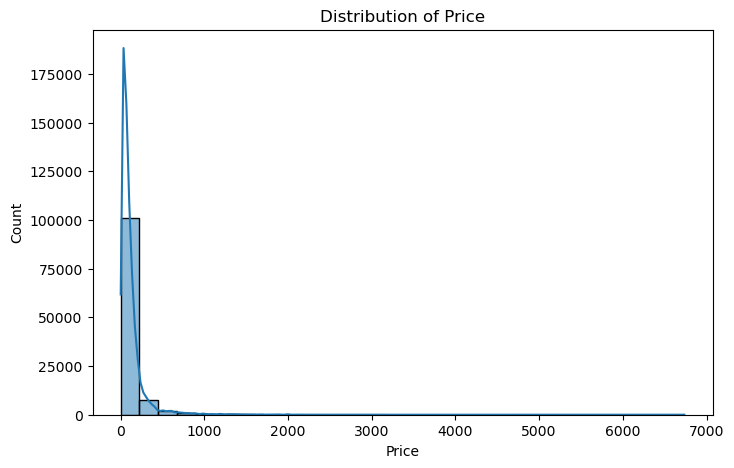

In [236]:
# Histogram for price distribution
plt.figure(figsize=(8, 5))
sns.histplot(databases['order_items_df']['price'], bins=30, kde=True)
plt.title('Distribution of Price')
plt.xlabel('Price')
plt.ylabel('Count')
plt.show()

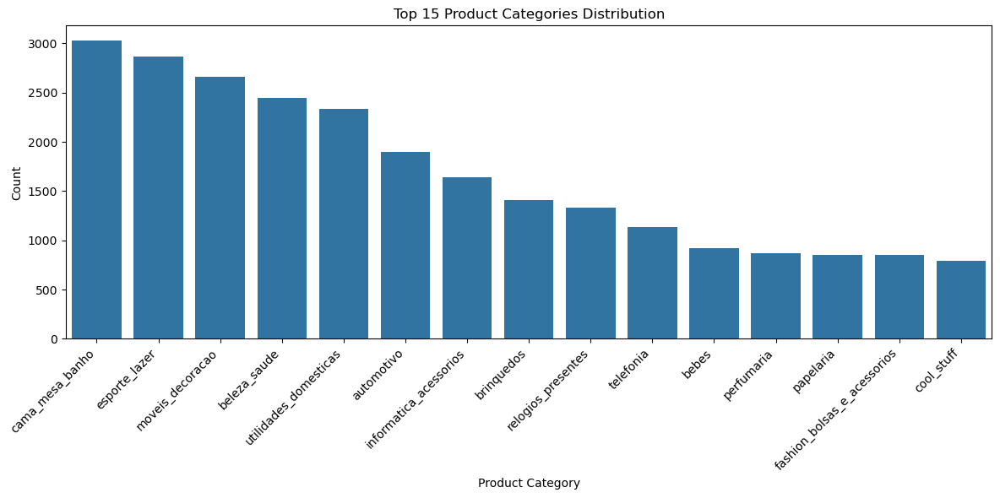

In [242]:
# Bar chart for category distributi0on
plt.figure(figsize=(12, 6))
category_counts = databases['products_df']['product_category_name'].value_counts().head(15)
sns.barplot(x=category_counts.index, y=category_counts.values)
plt.xticks(rotation=45, ha='right')
plt.title('Top 15 Product Categories Distribution')
plt.ylabel('Count')
plt.xlabel('Product Category')
plt.tight_layout()
plt.show()

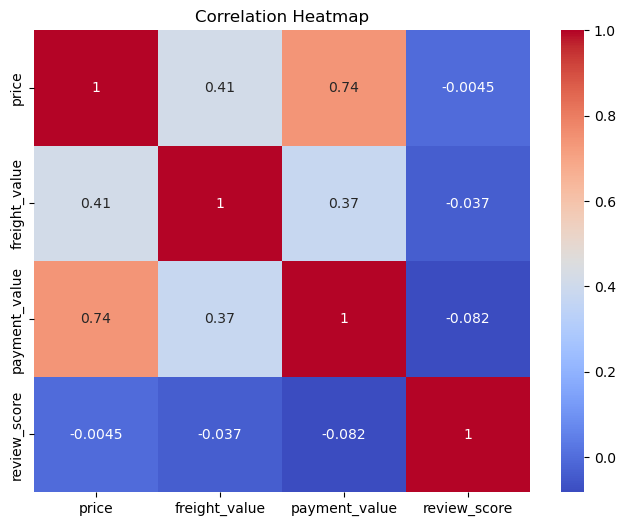

In [244]:
# Correlation heatmap
# Merge relevant columns from different DataFrames
merged_df = databases['order_items_df'][['order_id', 'price', 'freight_value']]\
    .merge(databases['payments_df'][['order_id', 'payment_value']], on='order_id', how='inner')\
    .merge(databases['reviews_df'][['order_id', 'review_score']], on='order_id', how='inner')

plt.figure(figsize=(8, 6))
sns.heatmap(merged_df[['price', 'freight_value', 'payment_value', 'review_score']].corr(), annot=True, cmap='coolwarm')
plt.title('Correlation Heatmap')
plt.show()

# Data Cleaning & Transformation

In [ ]:
for name, df in databases.items():
    print(f"{name}: {df.shape[0]} rows, {df.shape[1]} columns")

customers_df: 99441 rows, 5 columns
geolocation_df: 1000163 rows, 5 columns
orders_df: 99441 rows, 8 columns
order_items_df: 112650 rows, 7 columns
payments_df: 103886 rows, 5 columns
reviews_df: 99224 rows, 7 columns
products_df: 32951 rows, 9 columns
sellers_df: 3095 rows, 4 columns
category_translation_df: 71 rows, 2 columns


In [13]:
for name, df in databases.items():
    print(f"\nPreview of {name}:")
    display(df.head())


Preview of customers_df:


,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP



Preview of geolocation_df:


,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state
0,1037,-23.545621,-46.639292,sao paulo,SP
1,1046,-23.546081,-46.644820,sao paulo,SP
2,1046,-23.546129,-46.642951,sao paulo,SP
3,1041,-23.544392,-46.639499,sao paulo,SP
4,1035,-23.541578,-46.641607,sao paulo,SP



Preview of orders_df:


,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04 00:00:00
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15 00:00:00
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26 00:00:00



Preview of order_items_df:


,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value
0,00010242fe8c5a6d1ba2dd792cb16214,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2017-09-19 09:45:35,58.90,13.29
1,00018f77f2f0320c557190d7a144bdd3,1,e5f2d52b802189ee658865ca93d83a8f,dd7ddc04e1b6c2c614352b383efe2d36,2017-05-03 11:05:13,239.90,19.93
2,000229ec398224ef6ca0657da4fc703e,1,c777355d18b72b67abbeef9df44fd0fd,5b51032eddd242adc84c38acab88f23d,2018-01-18 14:48:30,199.00,17.87
3,00024acbcdf0a6daa1e931b038114c75,1,7634da152a4610f1595efa32f14722fc,9d7a1d34a5052409006425275ba1c2b4,2018-08-15 10:10:18,12.99,12.79
4,00042b26cf59d7ce69dfabb4e55b4fd9,1,ac6c3623068f30de03045865e4e10089,df560393f3a51e74553ab94004ba5c87,2017-02-13 13:57:51,199.90,18.14



Preview of payments_df:


,order_id,payment_sequential,payment_type,payment_installments,payment_value
0,b81ef226f3fe1789b1e8b2acac839d17,1,credit_card,8,99.33
1,a9810da82917af2d9aefd1278f1dcfa0,1,credit_card,1,24.39
2,25e8ea4e93396b6fa0d3dd708e76c1bd,1,credit_card,1,65.71
3,ba78997921bbcdc1373bb41e913ab953,1,credit_card,8,107.78
4,42fdf880ba16b47b59251dd489d4441a,1,credit_card,2,128.45



Preview of reviews_df:


,review_id,order_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
0,7bc2406110b926393aa56f80a40eba40,73fc7af87114b39712e6da79b0a377eb,4,NaN,NaN,2018-01-18 00:00:00,2018-01-18 21:46:59
1,80e641a11e56f04c1ad469d5645fdfde,a548910a1c6147796b98fdf73dbeba33,5,NaN,NaN,2018-03-10 00:00:00,2018-03-11 03:05:13
2,228ce5500dc1d8e020d8d1322874b6f0,f9e4b658b201a9f2ecdecbb34bed034b,5,NaN,NaN,2018-02-17 00:00:00,2018-02-18 14:36:24
3,e64fb393e7b32834bb789ff8bb30750e,658677c97b385a9be170737859d3511b,5,NaN,Recebi bem antes do prazo estipulado.,2017-04-21 00:00:00,2017-04-21 22:02:06
4,f7c4243c7fe1938f181bec41a392bdeb,8e6bfb81e283fa7e4f11123a3fb894f1,5,NaN,Parabéns lojas lannister adorei comprar pela I...,2018-03-01 00:00:00,2018-03-02 10:26:53



Preview of products_df:


,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
0,1e9e8ef04dbcff4541ed26657ea517e5,perfumaria,40.0,287.0,1.0,225.0,16.0,10.0,14.0
1,3aa071139cb16b67ca9e5dea641aaa2f,artes,44.0,276.0,1.0,1000.0,30.0,18.0,20.0
2,96bd76ec8810374ed1b65e291975717f,esporte_lazer,46.0,250.0,1.0,154.0,18.0,9.0,15.0
3,cef67bcfe19066a932b7673e239eb23d,bebes,27.0,261.0,1.0,371.0,26.0,4.0,26.0
4,9dc1a7de274444849c219cff195d0b71,utilidades_domesticas,37.0,402.0,4.0,625.0,20.0,17.0,13.0



Preview of sellers_df:


,seller_id,seller_zip_code_prefix,seller_city,seller_state
0,3442f8959a84dea7ee197c632cb2df15,13023,campinas,SP
1,d1b65fc7debc3361ea86b5f14c68d2e2,13844,mogi guacu,SP
2,ce3ad9de960102d0677a81f5d0bb7b2d,20031,rio de janeiro,RJ
3,c0f3eea2e14555b6faeea3dd58c1b1c3,4195,sao paulo,SP
4,51a04a8a6bdcb23deccc82b0b80742cf,12914,braganca paulista,SP



Preview of category_translation_df:


,product_category_name,product_category_name_english
0,beleza_saude,health_beauty
1,informatica_acessorios,computers_accessories
2,automotivo,auto
3,cama_mesa_banho,bed_bath_table
4,moveis_decoracao,furniture_decor


In [3]:
for name, df in databases.items():
    print(f"\n📊 Table: {name}")
    print(f"Shape: {df.shape}")
    print(df.isnull().sum())


📊 Table: customers_df
Shape: (99441, 5)
customer_id                 0
customer_unique_id          0
customer_zip_code_prefix    0
customer_city               0
customer_state              0
dtype: int64

📊 Table: geolocation_df
Shape: (1000163, 5)
geolocation_zip_code_prefix    0
geolocation_lat                0
geolocation_lng                0
geolocation_city               0
geolocation_state              0
dtype: int64

📊 Table: orders_df
Shape: (99441, 8)
order_id                            0
customer_id                         0
order_status                        0
order_purchase_timestamp            0
order_approved_at                 160
order_delivered_carrier_date     1783
order_delivered_customer_date    2965
order_estimated_delivery_date       0
dtype: int64

📊 Table: order_items_df
Shape: (112650, 7)
order_id               0
order_item_id          0
product_id             0
seller_id              0
shipping_limit_date    0
price                  0
freight_value          0

In [16]:
# ORDERS TABLE CLEANING
orders_clean = databases['orders_df'].copy()

# Drop rows in the orders_clean (cleaned) dataframe where any of the date columns are missing
orders_clean = orders_clean.dropna(subset=['order_approved_at', 
                                           'order_delivered_carrier_date', 
                                           'order_delivered_customer_date', 
                                           'order_estimated_delivery_date'])

# Print the shape of the dataframes after dropping the rows
print(f"Orders table after dropping missing dates: {orders_clean.shape}")

# Convert datetime columns
date_cols = ['order_purchase_timestamp', 'order_approved_at', 'order_delivered_carrier_date', 
             'order_delivered_customer_date', 'order_estimated_delivery_date']
for col in date_cols:
    orders_clean[col] = pd.to_datetime(orders_clean[col], errors='coerce')

# Add flags for order pipeline stages
orders_clean['is_approved'] = orders_clean['order_approved_at'].notna()
orders_clean['is_shipped'] = orders_clean['order_delivered_carrier_date'].notna()
orders_clean['is_delivered'] = orders_clean['order_delivered_customer_date'].notna()

# Calculate delivery metrics (only for delivered orders)
delivered_orders = orders_clean[orders_clean['is_delivered']].copy()
if not delivered_orders.empty:
    delivered_orders['delivery_time_days'] = (delivered_orders['order_delivered_customer_date'] - 
                                             delivered_orders['order_purchase_timestamp']).dt.days
    delivered_orders['estimated_vs_actual'] = (delivered_orders['order_estimated_delivery_date'] - 
                                              delivered_orders['order_delivered_customer_date']).dt.days
    
    # Add these metrics back to the main dataframe
    orders_clean = orders_clean.merge(delivered_orders[['order_id', 'delivery_time_days', 'estimated_vs_actual']], 
                                     on='order_id', how='left')

# Update the database
orders_clean.to_sql('orders', con=engine, if_exists='replace', index=False,
                   dtype={
                       'order_id': sqlalchemy.types.VARCHAR(50),
                       'customer_id': sqlalchemy.types.VARCHAR(50),
                       'order_status': sqlalchemy.types.VARCHAR(20),
                       'order_purchase_timestamp': sqlalchemy.types.DATETIME(),
                       'order_approved_at': sqlalchemy.types.DATETIME(),
                       'order_delivered_carrier_date': sqlalchemy.types.DATETIME(),
                       'order_delivered_customer_date': sqlalchemy.types.DATETIME(),
                       'order_estimated_delivery_date': sqlalchemy.types.DATETIME(),
                       'is_approved': sqlalchemy.types.BOOLEAN(),
                       'is_shipped': sqlalchemy.types.BOOLEAN(),
                       'is_delivered': sqlalchemy.types.BOOLEAN(),
                       'delivery_time_days': sqlalchemy.types.INTEGER(),
                       'estimated_vs_actual': sqlalchemy.types.INTEGER()
                   })

print("Orders table updated with cleaned data")

Orders table after dropping missing dates: (96461, 8)
Orders table updated with cleaned data


In [ ]:
# REVIEWS TABLE CLEANING
reviews_clean = databases['reviews_df'].copy()

# Drop rows in the reviews_clean (cleaned) dataframe where any of the date columns are missing
reviews_clean = reviews_clean.dropna(subset=['review_creation_date', 
                                             'review_answer_timestamp'])

# Convert datetime columns
date_cols = ['review_creation_date', 'review_answer_timestamp']
for col in date_cols:
    reviews_clean[col] = pd.to_datetime(reviews_clean[col], errors='coerce')

# Replace missing text with empty strings
reviews_clean['review_comment_title'] = reviews_clean['review_comment_title'].fillna('')
reviews_clean['review_comment_message'] = reviews_clean['review_comment_message'].fillna('')

# Add a flag for reviews with comments
reviews_clean['has_comment'] = (reviews_clean['review_comment_message'] != '').astype(int)

# Update the database
reviews_clean.to_sql('reviews', con=engine, if_exists='replace', index=False,
                    dtype={
                        'review_id': sqlalchemy.types.VARCHAR(50),
                        'order_id': sqlalchemy.types.VARCHAR(50),
                        'review_score': sqlalchemy.types.INTEGER(),
                        'review_comment_title': sqlalchemy.types.TEXT(),
                        'review_comment_message': sqlalchemy.types.TEXT(),
                        'review_creation_date': sqlalchemy.types.DATETIME(),
                        'review_answer_timestamp': sqlalchemy.types.DATETIME(),
                        'has_comment': sqlalchemy.types.BOOLEAN()
                    })

print("Reviews table updated with cleaned data")

In [5]:
# 1. Inspect the shape of the cleaned tables
print("Orders Table (Cleaned) Shape: ", orders_clean.shape)
print("Reviews Table (Cleaned) Shape: ", reviews_clean.shape)

# 2. Check for any remaining missing values in both tables
print("\nMissing values in Orders Table:")
print(orders_clean.isna().sum())

print("\nMissing values in Reviews Table:")
print(reviews_clean.isna().sum())

Orders Table (Cleaned) Shape:  (96461, 13)
Reviews Table (Cleaned) Shape:  (99224, 8)

Missing values in Orders Table:
order_id                         0
customer_id                      0
order_status                     0
order_purchase_timestamp         0
order_approved_at                0
order_delivered_carrier_date     0
order_delivered_customer_date    0
order_estimated_delivery_date    0
is_approved                      0
is_shipped                       0
is_delivered                     0
delivery_time_days               0
estimated_vs_actual              0
dtype: int64

Missing values in Reviews Table:
review_id                  0
order_id                   0
review_score               0
review_comment_title       0
review_comment_message     0
review_creation_date       0
review_answer_timestamp    0
has_comment                0
dtype: int64


In [20]:
import pandas as pd
import numpy as np

# Create copies of the dataframes
products_df = databases['products_df'].copy()

# Fix column name typos if needed
products_df = products_df.rename(columns={
    'product_name_lenght': 'product_name_length',
    'product_description_lenght': 'product_description_length'
})

# 1. Check for missing product categories and descriptions in the products_df
missing_meta = products_df[products_df['product_category_name'].isna()]
print(f"Missing category/description count: {missing_meta.shape[0]}")

# 2. Check how many unique product_ids have missing values
unique_missing_products = missing_meta['product_id'].nunique()
print(f"Unique product_ids with missing values: {unique_missing_products}")

# 3. Identify which of those missing product_ids are in the order_items_df (to potentially infer from usage)
order_items_df = databases['order_items_df'].copy()
products_in_orders = order_items_df[order_items_df['product_id'].isin(missing_meta['product_id'])]
print(f"Matching products in order_items: {products_in_orders.shape[0]}")

# Create a mapping of product_id to product_category_name from available products
product_category_mapping = {}

# Check if any products appear in multiple categories
product_categories = products_df.dropna(subset=['product_category_name'])[['product_id', 'product_category_name']]
products_with_multiple_cats = product_categories.groupby('product_id').filter(lambda x: len(x) > 1)

if len(products_with_multiple_cats) > 0:
    print(f"Warning: {len(products_with_multiple_cats)} products have multiple categories assigned.")
    # For products with multiple categories, use the most common one
    for product_id, group in products_with_multiple_cats.groupby('product_id'):
        most_common_category = group['product_category_name'].mode()[0]
        product_category_mapping[product_id] = most_common_category
else:
    # Create a clean mapping from product_id to category
    product_category_mapping = dict(zip(
        product_categories['product_id'],
        product_categories['product_category_name']
    ))

# 5. Check if we can infer categories for the missing products through their appearance in other rows
inferred_count = 0
for product_id in missing_meta['product_id']:
    if product_id in product_category_mapping:
        # Found a category for this product
        inferred_count += 1

print(f"Can infer categories for {inferred_count} missing products based on other rows.")

# 6. Fill missing categories with inferred values where possible
for idx, row in products_df[products_df['product_category_name'].isna()].iterrows():
    product_id = row['product_id']
    if product_id in product_category_mapping:
        products_df.loc[idx, 'product_category_name'] = product_category_mapping[product_id]

# 7. For any remaining missing categories, drop the observations
products_df = products_df.dropna(subset=['product_category_name'])

# 8. Handle missing product descriptions and dimensions
for col in ['product_name_length', 'product_description_length', 'product_photos_qty']:
    products_df[col] = products_df[col].fillna(0)  # Assuming 0 for missing text metrics

# 9. Physical dimensions require more careful handling
dimensions = ['product_weight_g', 'product_length_cm', 'product_height_cm', 'product_width_cm']

# Fill with category median where possible; drop rows if no category data is available
for dim in dimensions:
    # Group by category and fill with the median of that category
    category_medians = products_df.groupby('product_category_name')[dim].transform('median')
    products_df[dim] = products_df[dim].fillna(category_medians)
    
    # If still missing (new category with no data), drop those rows
    products_df = products_df.dropna(subset=[dim])

# Check the results
print("\nMissing values after cleaning:")
print(products_df.isnull().sum())

# Output cleaned data sample
print("\nCleaned data sample:")
print(products_df.head())

# Save the cleaned dataframe to MySQL
products_df.to_sql('products', con=engine, if_exists='replace', index=False,
                  dtype={
                      'product_id': sqlalchemy.types.VARCHAR(50),
                      'product_category_name': sqlalchemy.types.VARCHAR(100),
                      'product_name_length': sqlalchemy.types.FLOAT(),
                      'product_description_length': sqlalchemy.types.FLOAT(),
                      'product_photos_qty': sqlalchemy.types.FLOAT(),
                      'product_weight_g': sqlalchemy.types.FLOAT(),
                      'product_length_cm': sqlalchemy.types.FLOAT(),
                      'product_height_cm': sqlalchemy.types.FLOAT(),
                      'product_width_cm': sqlalchemy.types.FLOAT()
                  })

print("Products table updated with cleaned data")

Missing category/description count: 610
Unique product_ids with missing values: 610
Matching products in order_items: 1603
Can infer categories for 0 missing products based on other rows.

Missing values after cleaning:
product_id                    0
product_category_name         0
product_name_length           0
product_description_length    0
product_photos_qty            0
product_weight_g              0
product_length_cm             0
product_height_cm             0
product_width_cm              0
dtype: int64

Cleaned data sample:
                         product_id  product_category_name  \
0  1e9e8ef04dbcff4541ed26657ea517e5             perfumaria   
1  3aa071139cb16b67ca9e5dea641aaa2f                  artes   
2  96bd76ec8810374ed1b65e291975717f          esporte_lazer   
3  cef67bcfe19066a932b7673e239eb23d                  bebes   
4  9dc1a7de274444849c219cff195d0b71  utilidades_domesticas   

   product_name_length  product_description_length  product_photos_qty  \
0         

In [22]:
# Validate product dimensions
with engine.connect() as conn:
    # Check for any remaining NULL values in product dimensions
    product_nulls = pd.read_sql("""
        SELECT COUNT(*) as null_count
        FROM products
        WHERE product_weight_g IS NULL 
           OR product_length_cm IS NULL
           OR product_height_cm IS NULL
           OR product_width_cm IS NULL
    """, conn)
    
    print(f"Products with NULL dimensions after cleaning: {product_nulls['null_count'].iloc[0]}")
    
    # Check for invalid dimensions (negative or zero)
    invalid_dimensions = pd.read_sql("""
        SELECT COUNT(*) as invalid_count
        FROM products
        WHERE product_weight_g <= 0 
           OR product_length_cm <= 0
           OR product_height_cm <= 0
           OR product_width_cm <= 0
    """, conn)
    
    print(f"Products with invalid dimensions after cleaning: {invalid_dimensions['invalid_count'].iloc[0]}")
    
    # Validate order dates (no delivery before purchase)
    invalid_dates = pd.read_sql("""
        SELECT COUNT(*) as invalid_count
        FROM orders
        WHERE order_delivered_customer_date IS NOT NULL
          AND order_delivered_customer_date < order_purchase_timestamp
    """, conn)
    
    print(f"Orders with invalid dates (delivery before purchase): {invalid_dates['invalid_count'].iloc[0]}")

Products with NULL dimensions after cleaning: 0
Products with invalid dimensions after cleaning: 4
Orders with invalid dates (delivery before purchase): 0


In [24]:
# 1. Identify invalid dimensions (e.g., negative or zero values)
invalid_dimensions = products_df[[
    'product_weight_g', 'product_length_cm', 
    'product_height_cm', 'product_width_cm']].le(0).any(axis=1)

# Count invalid rows
invalid_rows_count = invalid_dimensions.sum()
print(f"Invalid dimension rows: {invalid_rows_count}")

# Display invalid rows (if any)
if invalid_rows_count > 0:
    print("\nInvalid dimension rows:")
    print(products_df[invalid_dimensions])

# 2. Handle invalid dimensions: Option 1 - Remove invalid rows
products_df_cleaned = products_df[~invalid_dimensions]

# 3. Check final number of invalid rows
print("\nNumber of invalid dimension rows after cleaning (if any were dropped):")
print(products_df_cleaned.isnull().sum())

# 4. Update the database with cleaned data (if needed)
# Uncomment to save back to the database
#products_df_cleaned.to_sql('products', con=engine, if_exists='replace', index=False)

Invalid dimension rows: 4

Invalid dimension rows:
                             product_id product_category_name  \
9769   81781c0fed9fe1ad6e8c81fca1e1cb08       cama_mesa_banho   
13683  8038040ee2a71048d4bdbbdc985b69ab       cama_mesa_banho   
14997  36ba42dd187055e1fbe943b2d11430ca       cama_mesa_banho   
32079  e673e90efa65a5409ff4196c038bb5af       cama_mesa_banho   

       product_name_length  product_description_length  product_photos_qty  \
9769                  51.0                       529.0                 1.0   
13683                 48.0                       528.0                 1.0   
14997                 53.0                       528.0                 1.0   
32079                 53.0                       528.0                 1.0   

       product_weight_g  product_length_cm  product_height_cm  \
9769                0.0               30.0               25.0   
13683               0.0               30.0               25.0   
14997               0.0              

In [28]:
import numpy as np
from sklearn.impute import KNNImputer

# Replace 0 with NaN only in weight
products_df['product_weight_g'] = products_df['product_weight_g'].replace(0, np.nan)
# Select relevant features for KNN
knn_features = ['product_weight_g', 'product_photos_qty',
                'product_length_cm', 'product_height_cm', 'product_width_cm']

# Initialize imputer
imputer = KNNImputer(n_neighbors=5)

# Apply KNN on relevant columns
products_df[knn_features] = imputer.fit_transform(products_df[knn_features])

In [30]:
# Drop rows where any of the dimension columns are less than or equal to 0
products_df = products_df[
    (products_df['product_weight_g'] > 0) &
    (products_df['product_length_cm'] > 0) &
    (products_df['product_height_cm'] > 0) &
    (products_df['product_width_cm'] > 0)
]

In [32]:
with engine.connect() as conn:
    products_df.to_sql('products', con=conn, if_exists='replace', index=False)

print("Invalid product dimension rows dropped and table updated.")

Invalid product dimension rows dropped and table updated.


In [34]:
with engine.connect() as conn:
    # Check for any remaining NULL values in product dimensions
    product_nulls = pd.read_sql("""
        SELECT COUNT(*) AS null_count
        FROM products
        WHERE product_weight_g IS NULL 
           OR product_length_cm IS NULL
           OR product_height_cm IS NULL
           OR product_width_cm IS NULL
    """, conn)
    print(f" Products with NULL dimensions: {product_nulls['null_count'].iloc[0]}")
    
    # Check for invalid dimensions (negative or zero)
    invalid_dimensions = pd.read_sql("""
        SELECT COUNT(*) AS invalid_count
        FROM products
        WHERE product_weight_g <= 0 
           OR product_length_cm <= 0
           OR product_height_cm <= 0
           OR product_width_cm <= 0
    """, conn)
    print(f" Products with invalid dimensions (zero or negative): {invalid_dimensions['invalid_count'].iloc[0]}")

 Products with NULL dimensions: 0
 Products with invalid dimensions (zero or negative): 0


In [36]:
# Check duplicates
for name, df in databases.items():
    duplicate_count = df.duplicated().sum()
    print(f"{name}: {duplicate_count} duplicate rows")

customers_df: 0 duplicate rows
geolocation_df: 261831 duplicate rows
orders_df: 0 duplicate rows
order_items_df: 0 duplicate rows
payments_df: 0 duplicate rows
reviews_df: 0 duplicate rows
products_df: 0 duplicate rows
sellers_df: 0 duplicate rows
category_translation_df: 0 duplicate rows


In [38]:
with engine.connect() as conn:
    duplicate_geolocations = pd.read_sql("""
        SELECT geolocation_zip_code_prefix, geolocation_lat, geolocation_lng, COUNT(*) as count
        FROM geolocation
        GROUP BY geolocation_zip_code_prefix, geolocation_lat, geolocation_lng
        HAVING COUNT(*) > 1
    """, conn)

print(f"Number of duplicated geolocation groups: {len(duplicate_geolocations)}")
display(duplicate_geolocations.head())

Number of duplicated geolocation groups: 131786


,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,count
0,1001,-23.5513,-46.6340,3
1,1001,-23.5505,-46.6343,8
2,1001,-23.5498,-46.6340,2
3,1001,-23.5498,-46.6340,2
4,1001,-23.5493,-46.6336,6


In [40]:
# Load geolocation table from DB
with engine.connect() as conn:
    geolocation_df = pd.read_sql("SELECT * FROM geolocation", conn)

# Drop duplicates based on relevant columns
geolocation_cleaned = geolocation_df.drop_duplicates(
    subset=['geolocation_zip_code_prefix', 'geolocation_lat', 'geolocation_lng'],
    keep='first'
)

# Replace the table in MySQL
geolocation_cleaned.to_sql('geolocation', con=engine, if_exists='replace', index=False)

print(f"Duplicates dropped. New geolocation row count: {len(geolocation_cleaned)}")

Duplicates dropped. New geolocation row count: 707318


In [41]:
with engine.connect() as conn:
    result = conn.execute(text("SELECT COUNT(*) FROM orders"))
    print("Total orders:", result.scalar())

Total orders: 96461


# Data Querying & Insights:

In [50]:
from sqlalchemy import text

with engine.connect() as conn:
    # Create or replace the view 'order_summary'
    conn.execute(text("""
        CREATE OR REPLACE VIEW order_summary AS
        SELECT 
            o.order_id,
            c.customer_state,
            p.payment_value,
            r.review_score
        FROM orders o
        JOIN customers c ON o.customer_id = c.customer_id
        LEFT JOIN payments p ON o.order_id = p.order_id
        LEFT JOIN reviews r ON o.order_id = r.order_id;
    """))
    
    # Fetch results from the view to print
    result = conn.execute(text("SELECT * FROM order_summary LIMIT 10;"))
    
    # Print out the first 10 rows of the view
    print("First 10 rows from the 'order_summary' view:")
    for row in result:
        print(row)

First 10 rows from the 'order_summary' view:
('b170f1243a620b65504157b83f69a2e0', 'SP', 80.15, 5)
('468c2f34312a6d270a20c7aef082041c', 'GO', 51.0, 2)
('e08878ad70acad81d0e90f59e56ce9a6', 'SP', 84.79, 3)
('ccf15697e8a9c460dd3bab4f04270c9b', 'PR', 241.61, 2)
('d60a89ab9bc1e68834465ae630c3343e', 'MG', 115.59, 5)
('54b73f808b0ff25da4276773c30ac269', 'MG', 105.28, 5)
('a0f3677ac2cfd35a8d76f4a26fb29a95', 'SP', 144.8, 5)
('0bfa8870838091fe8171ed69f6b89fee', 'SP', 64.86, 5)
('fe642627ef34edffd9e897365f2d0449', 'SP', 63.74, 4)
('cf30fe76d1505192acee1c6dccb15545', 'SP', 47.72, 5)


In [52]:
# Query 1: Orders by Status
orders_by_status = pd.read_sql("""
    SELECT order_status, COUNT(*) AS count
    FROM orders
    GROUP BY order_status
    ORDER BY count DESC
""", con=engine)
print("\nOrders by Status:")
print(orders_by_status)

# Query 2: Top Selling Categories
top_categories = pd.read_sql("""
    SELECT
        COALESCE(ct.product_category_name_english, p.product_category_name) AS category,
        COUNT(*) AS items_sold,
        SUM(oi.price) AS total_revenue
    FROM
        order_items oi
    JOIN
        products p ON oi.product_id = p.product_id
    LEFT JOIN
        category_translation ct ON p.product_category_name = ct.product_category_name
    GROUP BY
        category
    ORDER BY
        items_sold DESC
    LIMIT 10
""", con=engine)
print("\nTop Selling Categories:")
print(top_categories)


Orders by Status:
  order_status  count
0    delivered  96455
1     canceled      6

Top Selling Categories:
                category  items_sold  total_revenue
0         bed_bath_table       11115   1.036989e+06
1          health_beauty        9670   1.258681e+06
2         sports_leisure        8641   9.880490e+05
3        furniture_decor        8334   7.297625e+05
4  computers_accessories        7827   9.119543e+05
5             housewares        6964   6.322487e+05
6          watches_gifts        5991   1.205006e+06
7              telephony        4545   3.236675e+05
8           garden_tools        4347   4.852565e+05
9                   auto        4235   5.927201e+05


In [54]:
# Query 3: Customer Distribution by State
customer_by_state = pd.read_sql("""
    SELECT customer_state, COUNT(*) AS count
    FROM customers
    GROUP BY customer_state
    ORDER BY count DESC
""", con=engine)
print("\nCustomer Distribution by State:")
print(customer_by_state)


# Query 4: Delivery Time Stats
delivery_time = pd.read_sql("""
    SELECT
        ROUND(AVG(DATEDIFF(order_delivered_customer_date, order_purchase_timestamp)), 2) AS avg_delivery_days,
        MIN(DATEDIFF(order_delivered_customer_date, order_purchase_timestamp)) AS min_delivery_days,
        MAX(DATEDIFF(order_delivered_customer_date, order_purchase_timestamp)) AS max_delivery_days
    FROM
        orders
    WHERE
        order_delivered_customer_date IS NOT NULL
        AND order_purchase_timestamp IS NOT NULL
""", con=engine)
print("\nDelivery Time Statistics (in days):")
print(delivery_time)


Customer Distribution by State:
   customer_state  count
0              SP  41746
1              RJ  12852
2              MG  11635
3              RS   5466
4              PR   5045
5              SC   3637
6              BA   3380
7              DF   2140
8              ES   2033
9              GO   2020
10             PE   1652
11             CE   1336
12             PA    975
13             MT    907
14             MA    747
15             MS    715
16             PB    536
17             PI    495
18             RN    485
19             AL    413
20             SE    350
21             TO    280
22             RO    253
23             AM    148
24             AC     81
25             AP     68
26             RR     46

Delivery Time Statistics (in days):
   avg_delivery_days  min_delivery_days  max_delivery_days
0               12.5                  0                210


In [56]:
# Query 5: Review Score Distribution
review_scores = pd.read_sql("""
    SELECT review_score, COUNT(*) AS count
    FROM reviews
    GROUP BY review_score
    ORDER BY review_score
""", con=engine)
print("\nReview Score Distribution:")
print(review_scores)


Review Score Distribution:
   review_score  count
0             1  11424
1             2   3151
2             3   8179
3             4  19142
4             5  57328


In [58]:
# Query 6: Top 10 Product Categories by Average Review Score (with >50 Reviews)
avg_review_by_category = pd.read_sql("""
    SELECT
        COALESCE(ct.product_category_name_english, p.product_category_name) AS category,
        ROUND(AVG(r.review_score), 2) AS avg_review_score,
        COUNT(*) AS total_reviews
    FROM
        reviews r
    JOIN
        orders o ON r.order_id = o.order_id
    JOIN
        order_items oi ON o.order_id = oi.order_id
    JOIN
        products p ON oi.product_id = p.product_id
    LEFT JOIN
        category_translation ct ON p.product_category_name = ct.product_category_name
    GROUP BY
        category
    HAVING
        total_reviews > 50
    ORDER BY
        avg_review_score DESC
    LIMIT 10
""", con=engine)
print("\nAverage Review Score per Product Category:")
print(avg_review_by_category)


Average Review Score per Product Category:
                                category  avg_review_score  total_reviews
0                 books_general_interest              4.51            532
1                         books_imported              4.51             57
2                costruction_tools_tools              4.44             99
3  small_appliances_home_oven_and_coffee              4.44             73
4                        books_technical              4.39            264
5                             food_drink              4.37            271
6                    luggage_accessories              4.35           1073
7                             cine_photo              4.30             71
8                          fashion_shoes              4.29            256
9                                   food              4.26            487


In [60]:
# Query 7: Top 10 Product Categories by Number of Products

product_count_by_category = pd.read_sql("""
    SELECT
        COALESCE(ct.product_category_name_english, p.product_category_name) AS category,
        COUNT(*) AS product_count
    FROM
        products p
    LEFT JOIN
        category_translation ct ON p.product_category_name = ct.product_category_name
    GROUP BY
        category
    ORDER BY
        product_count DESC
    LIMIT 10
""", con=engine)
print("\nNumber of Products per Category:")
print(product_count_by_category)


Number of Products per Category:
                category  product_count
0         bed_bath_table           3029
1         sports_leisure           2867
2        furniture_decor           2657
3          health_beauty           2444
4             housewares           2335
5                   auto           1900
6  computers_accessories           1639
7                   toys           1411
8          watches_gifts           1329
9              telephony           1134


In [62]:
# Query 8: Payment Type Usage and Total Payment Value

payment_types = pd.read_sql("""
    SELECT
        payment_type,
        COUNT(*) AS usage_count,
        ROUND(SUM(payment_value), 2) AS total_value
    FROM
        payments
    GROUP BY
        payment_type
    ORDER BY
        total_value DESC
""", con=engine)
print("\nPayment Type Usage:")
print(payment_types)


Payment Type Usage:
  payment_type  usage_count  total_value
0  credit_card        76795  12542084.19
1       boleto        19784   2869361.27
2      voucher         5775    379436.87
3   debit_card         1529    217989.79
4  not_defined            3         0.00


In [80]:
# Query 9: Monthly Order Volume

monthly_orders = pd.read_sql("""
    SELECT 
        DATE_FORMAT(order_purchase_timestamp, '%%Y-%%m') AS month,
        COUNT(*) AS total_orders
    FROM orders
    GROUP BY month
    ORDER BY month
""", con=engine)
print("\nMonthly Order Volume:")
print(monthly_orders)


Monthly Order Volume:
      month  total_orders
0   2016-09             1
1   2016-10           270
2   2016-12             1
3   2017-01           748
4   2017-02          1641
5   2017-03          2546
6   2017-04          2303
7   2017-05          3545
8   2017-06          3135
9   2017-07          3872
10  2017-08          4193
11  2017-09          4149
12  2017-10          4478
13  2017-11          7288
14  2017-12          5513
15  2018-01          7069
16  2018-02          6556
17  2018-03          7003
18  2018-04          6798
19  2018-05          6749
20  2018-06          6096
21  2018-07          6156
22  2018-08          6351


In [116]:
# Query 10: Number of Orders Delivered Late

query = """
SELECT 
    COUNT(order_id) AS late_orders
FROM orders
WHERE order_delivered_customer_date > order_estimated_delivery_date;
"""
print("\nNumber of Orders Delivered Late:")
late_orders_count = pd.read_sql(query, con=engine)
print(late_orders_count)


Number of Orders Delivered Late:
   late_orders
0         7826


In [130]:
# Query 11: Top 5 Customers by Total Spending

query = """
SELECT 
    o.customer_id,
    SUM(oi.price * oi.order_item_id) AS total_spent
FROM orders o
JOIN order_items oi ON o.order_id = oi.order_id
GROUP BY o.customer_id
ORDER BY total_spent DESC
LIMIT 5;
"""

print("\nTop 5 Customers by Total Spending:")
top_5_customers_by_spending = pd.read_sql(query, con=engine)
print(top_5_customers_by_spending)


Top 5 Customers by Total Spending:
                        customer_id   total_spent
0  1617b1357756262bfa56ab541c47bc16  60480.000000
1  be1b70680b9f9694d8c70f41fa3dc92b  21000.000000
2  05455dfa7cd02f13d132aa7a6a9729c6  20771.099487
3  bd5d39761aa56689a265d95d8d32b8be  20726.999359
4  ec5b2ba62e574342386871631fafd3fc  17900.000000


In [134]:
# Query 12: Top 5 Cities with the Most Orders

query = """
SELECT 
    c.customer_city,
    COUNT(o.order_id) AS total_orders
FROM orders o
JOIN customers c ON o.customer_id = c.customer_id
GROUP BY c.customer_city
ORDER BY total_orders DESC
LIMIT 5;
"""
print("\nTop 5 Cities with the Most Orders")
top_5_cities_by_orders = pd.read_sql(query, con=engine)
print(top_5_cities_by_orders)


Top 5 Cities with the Most Orders
    customer_city  total_orders
0       sao paulo         15044
1  rio de janeiro          6603
2  belo horizonte          2697
3        brasilia          2071
4        curitiba          1489


In [140]:
# Query 13: Top 10 sellers with the most late orders:
query = """
SELECT 
    oi.seller_id,
    COUNT(o.order_id) AS late_orders
FROM order_items oi
JOIN orders o ON oi.order_id = o.order_id
WHERE o.order_delivered_customer_date > o.order_estimated_delivery_date
GROUP BY oi.seller_id
ORDER BY late_orders DESC
LIMIT 10;
"""

print("\nTop 10 sellers with the most late orders:")
late_orders_by_seller = pd.read_sql(query, con=engine)
print(late_orders_by_seller)


Top 10 sellers with the most late orders:
                          seller_id  late_orders
0  4a3ca9315b744ce9f8e9374361493884          214
1  1f50f920176fa81dab994f9023523100          182
2  4869f7a5dfa277a7dca6462dcf3b52b2          133
3  1025f0e2d44d7041d6cf58b6550e0bfa          131
4  7c67e1448b00f6e969d365cea6b010ab          130
5  6560211a19b47992c3666cc44a7e94c0          124
6  ea8482cd71df3c1969d7b9473ff13abc          123
7  955fee9216a65b617aa5c0531780ce60          119
8  da8622b14eb17ae2831f4ac5b9dab84a          113
9  cc419e0650a3c5ba77189a1882b7556a          103


# Data Visualization & Reporting:

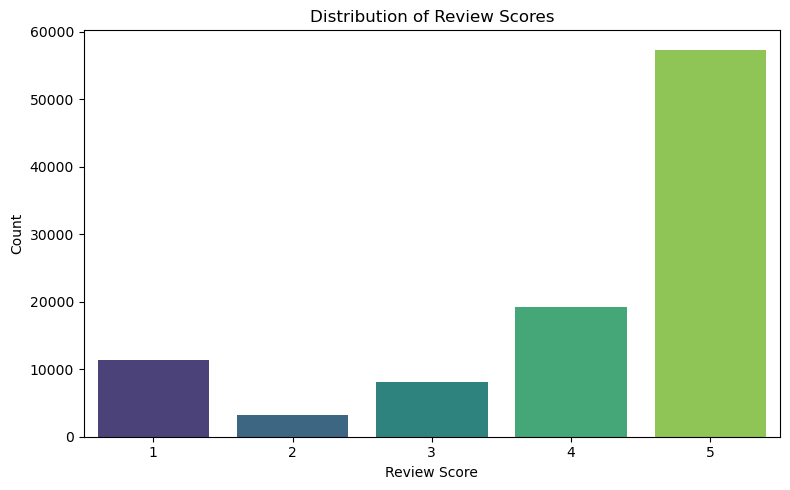

In [23]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(8,5))
sns.countplot(data=databases['reviews_df'], x='review_score', palette='viridis')
plt.title('Distribution of Review Scores')
plt.xlabel('Review Score')
plt.ylabel('Count')
plt.tight_layout()
plt.show()


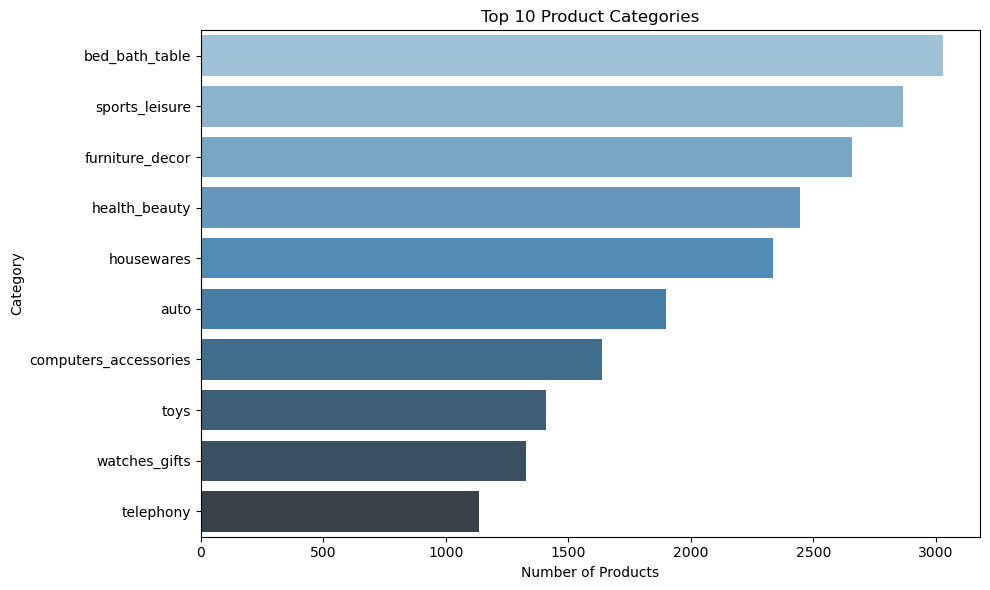

In [24]:
products = databases['products_df']
cat_trans = databases['category_translation_df']

# Merge category translations
merged = pd.merge(products, cat_trans, on='product_category_name', how='left')

top_categories = merged['product_category_name_english'].value_counts().nlargest(10)

plt.figure(figsize=(10,6))
sns.barplot(x=top_categories.values, y=top_categories.index, palette='Blues_d')
plt.title('Top 10 Product Categories')
plt.xlabel('Number of Products')
plt.ylabel('Category')
plt.tight_layout()
plt.show()


C:\Users\User\AppData\Local\Temp\ipykernel_27612\1329212127.py:11: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=city_counts.values, y=city_counts.index, palette="Blues_d")


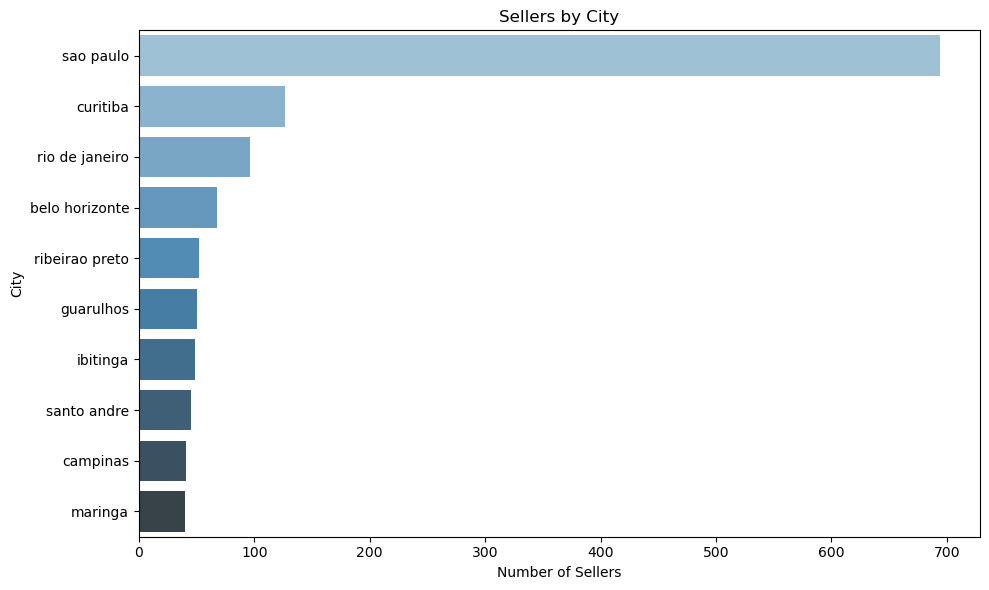

In [174]:
import matplotlib.pyplot as plt
import seaborn as sns

sellers_df = databases['sellers_df'] 

# Group sellers by city
city_counts = sellers_df['seller_city'].value_counts().head(10) 

# Plot
plt.figure(figsize=(10,6))
sns.barplot(x=city_counts.values, y=city_counts.index, palette="Blues_d")
plt.title('Sellers by City')
plt.xlabel('Number of Sellers')
plt.ylabel('City')
plt.tight_layout()
plt.show()  

C:\Users\User\AppData\Local\Temp\ipykernel_27612\4283405590.py:20: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=payment_counts.values, y=payment_counts.index, palette=colors)


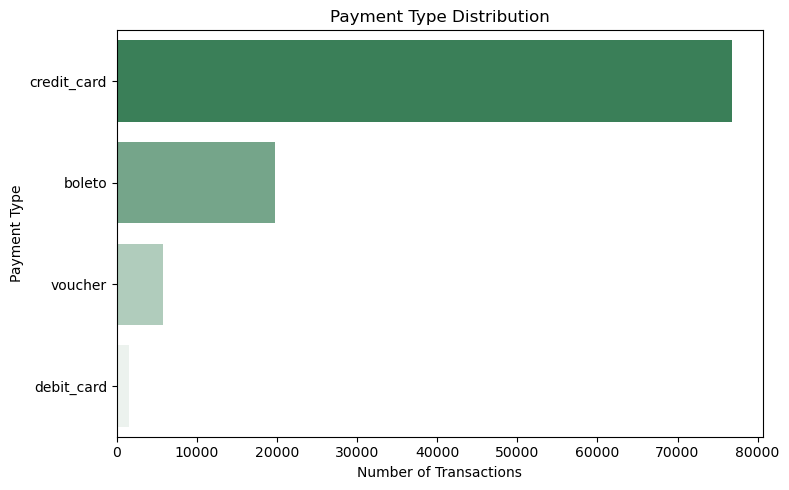

In [154]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Get payment counts
payments = databases['payments_df']
payment_counts = payments['payment_type'].value_counts()

# Drop 'not_defined'
payment_counts = payment_counts.drop('not_defined', errors='ignore')

# Sort in descending order
payment_counts = payment_counts.sort_values(ascending=False)

# Create a gradient from dark to light green 
colors = sns.light_palette("seagreen", n_colors=len(payment_counts), reverse=True)

# Plot
plt.figure(figsize=(8, 5))
sns.barplot(x=payment_counts.values, y=payment_counts.index, palette=colors)
plt.title('Payment Type Distribution')
plt.xlabel('Number of Transactions')
plt.ylabel('Payment Type')
plt.tight_layout()
plt.show()

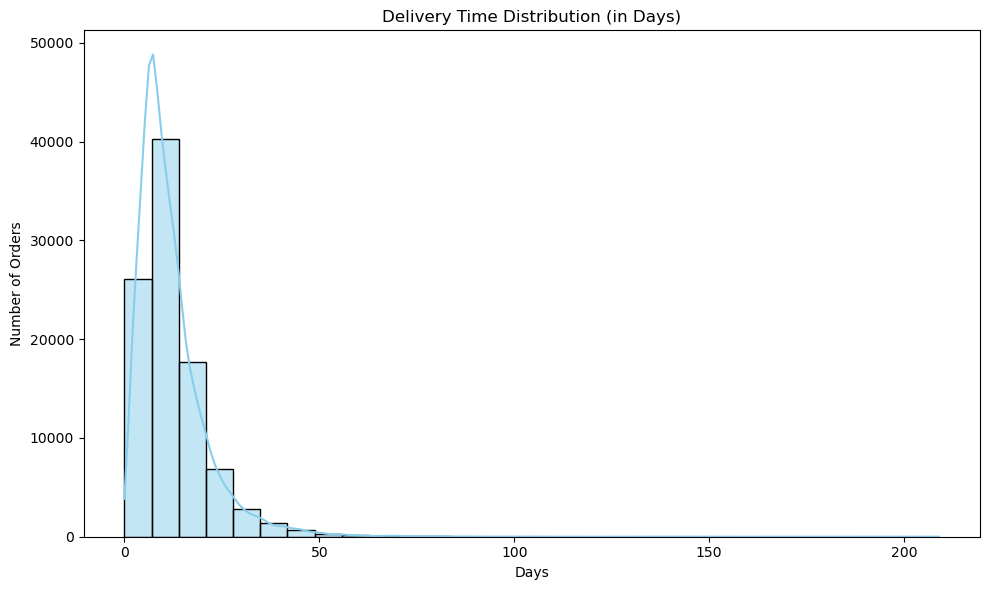

In [26]:
orders = databases['orders_df'].copy()
orders['order_delivered_customer_date'] = pd.to_datetime(orders['order_delivered_customer_date'])
orders['order_purchase_timestamp'] = pd.to_datetime(orders['order_purchase_timestamp'])

# Compute delivery time in days
orders['delivery_time'] = (orders['order_delivered_customer_date'] - orders['order_purchase_timestamp']).dt.days
orders = orders[orders['delivery_time'].notnull() & (orders['delivery_time'] >= 0)]  # remove negatives & nulls

plt.figure(figsize=(10,6))
sns.histplot(orders['delivery_time'], bins=30, kde=True, color='skyblue')
plt.title('Delivery Time Distribution (in Days)')
plt.xlabel('Days')
plt.ylabel('Number of Orders')
plt.tight_layout()
plt.show()


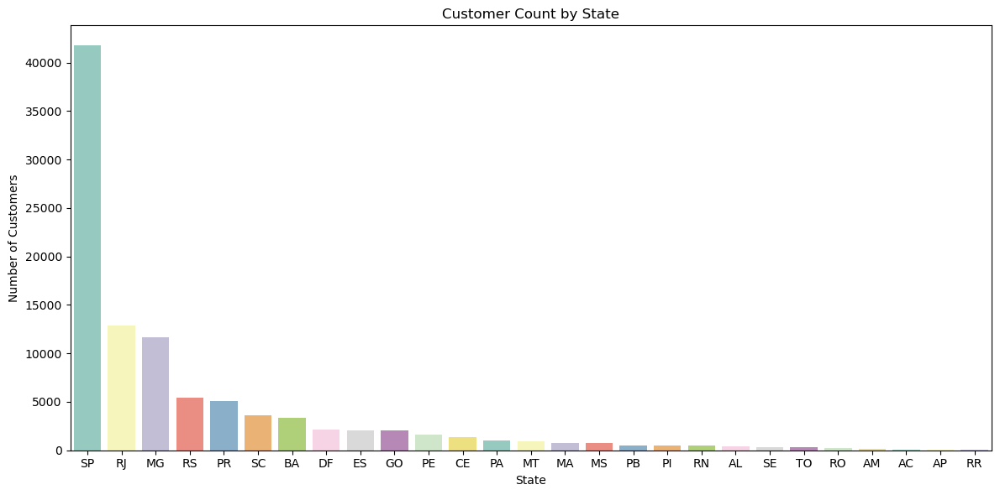

In [ ]:
customers = databases['customers_df']

plt.figure(figsize=(12,6))
sns.countplot(data=customers, x='customer_state', order=customers['customer_state'].value_counts().index, palette='Set3')
plt.title('Customer Count by State')
plt.xlabel('State') 
plt.ylabel('Number of Customers')
plt.tight_layout()
plt.show()


In [19]:
!pip install folium

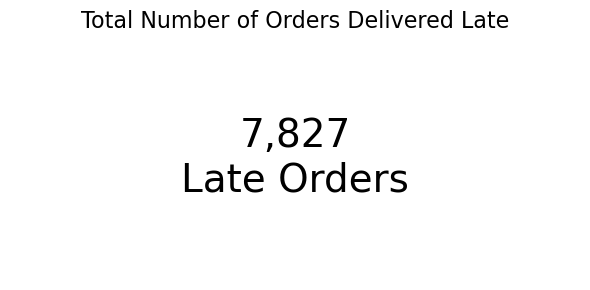

In [148]:
import matplotlib.pyplot as plt

total_late_orders = len(late_orders_count)

plt.figure(figsize=(6, 3))
plt.text(0.5, 0.5, f"{total_late_orders:,}\nLate Orders", fontsize=28, ha='center', va='center')
plt.axis('off')
plt.title('Total Number of Orders Delivered Late', fontsize=16)
plt.tight_layout()
plt.show()

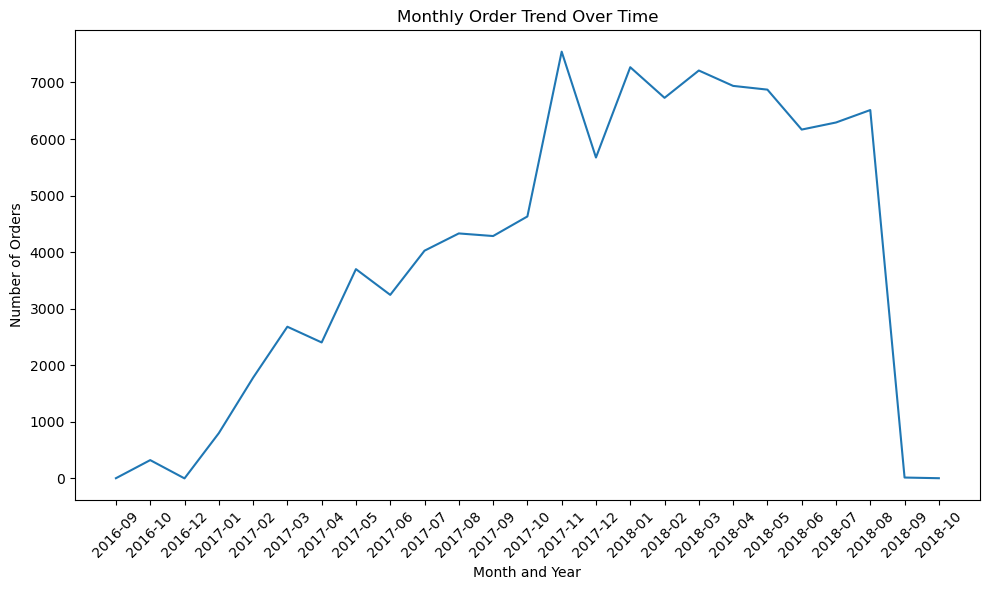

In [246]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Copy the orders dataframe
orders_df = databases['orders_df'].copy()

# Convert 'order_purchase_timestamp' to datetime (if not already)
orders_df['order_purchase_timestamp'] = pd.to_datetime(orders_df['order_purchase_timestamp'])

# Create a new column for order month and year (e.g., '2017-05')
orders_df['order_month_year'] = orders_df['order_purchase_timestamp'].dt.to_period('M')

# Group by month-year and count number of orders
monthly_order_trend = orders_df.groupby('order_month_year').size()

# Plot the trend
plt.figure(figsize=(10, 6))
sns.lineplot(x=monthly_order_trend.index.astype(str), y=monthly_order_trend.values)
plt.title("Monthly Order Trend Over Time")
plt.xlabel("Month and Year")
plt.ylabel("Number of Orders")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [156]:
import folium
from folium.plugins import MarkerCluster

# Load geolocation data
geo = databases['geolocation_df'].copy()

# Drop nulls and duplicates to avoid overcrowding
geo.dropna(subset=['geolocation_lat', 'geolocation_lng'], inplace=True)
geo = geo.drop_duplicates(subset=['geolocation_zip_code_prefix'])

# Create a base map centered on Brazil
m = folium.Map(location=[-14.2350, -51.9253], zoom_start=4)

# Add a marker cluster
marker_cluster = MarkerCluster().add_to(m)

# Add markers for each unique location (you can limit for performance if needed)
for idx, row in geo.iterrows():
    folium.Marker(
        location=[row['geolocation_lat'], row['geolocation_lng']],
        popup=f"City: {row['geolocation_city']}, State: {row['geolocation_state']}"
    ).add_to(marker_cluster)

# Show the map (in Jupyter) or save it
m.save("geolocation_map.html")
m

C:\Users\User\AppData\Local\Temp\ipykernel_27612\906331000.py:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax1 = sns.barplot(x=daily_order_trend.index, y=daily_order_trend.values, palette="viridis", ax=axes[0])
C:\Users\User\AppData\Local\Temp\ipykernel_27612\906331000.py:42: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax1.set_xticklabels(daily_order_trend.index, rotation=45)
C:\Users\User\AppData\Local\Temp\ipykernel_27612\906331000.py:45: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax2 = sns.barplot(x=time_of_day_order_trend.index, y=time_of_day_order_trend.values, palette="coolwarm", ax=axes[1])
C:\Users\User\AppData\L

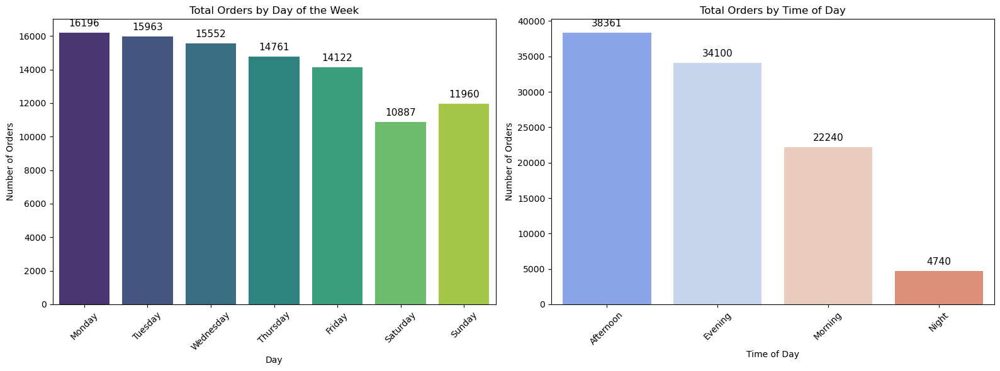

In [254]:
# Extract the day of the week from timestamp
orders_df['day_of_week'] = orders_df['order_purchase_timestamp'].dt.day_name()

# Count the number of orders per weekday
daily_order_trend = orders_df.groupby('day_of_week')['order_id'].count()

# Reorder days of the week starting from Monday
days_order = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
daily_order_trend = daily_order_trend.reindex(days_order)

# Extract the hour from timestamp
orders_df['order_hour'] = orders_df['order_purchase_timestamp'].dt.hour

# Categorize into time of day
def time_of_day(hour):
    if 6 <= hour < 12:
        return 'Morning'
    elif 12 <= hour < 18:
        return 'Afternoon'
    elif 18 <= hour < 24:
        return 'Evening'
    else:
        return 'Night'

orders_df['time_of_day'] = orders_df['order_hour'].apply(time_of_day)

# Count orders per time of day category
time_of_day_order_trend = orders_df['time_of_day'].value_counts()

# Plot both charts side by side
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Plot 1: Orders by Day of the Week
ax1 = sns.barplot(x=daily_order_trend.index, y=daily_order_trend.values, palette="viridis", ax=axes[0])
for p in ax1.patches:
    ax1.annotate(f'{int(p.get_height())}', (p.get_x() + p.get_width()/2, p.get_height()),
                 ha='center', va='bottom', fontsize=11, color='black', xytext=(0, 5),
                 textcoords='offset points')
ax1.set_title("Total Orders by Day of the Week")
ax1.set_xlabel("Day")
ax1.set_ylabel("Number of Orders")
ax1.set_xticklabels(daily_order_trend.index, rotation=45)

# Plot 2: Orders by Time of Day
ax2 = sns.barplot(x=time_of_day_order_trend.index, y=time_of_day_order_trend.values, palette="coolwarm", ax=axes[1])
for p in ax2.patches:
    ax2.annotate(f'{int(p.get_height())}', (p.get_x() + p.get_width()/2, p.get_height()),
                 ha='center', va='bottom', fontsize=11, color='black', xytext=(0, 5),
                 textcoords='offset points')
ax2.set_title("Total Orders by Time of Day")
ax2.set_xlabel("Time of Day")
ax2.set_ylabel("Number of Orders")
ax2.set_xticklabels(time_of_day_order_trend.index, rotation=45)

# Adjust layout
plt.tight_layout()
plt.show()

C:\Users\User\AppData\Local\Temp\ipykernel_27612\3270782526.py:22: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=top_10_categories_by_review.values, y=top_10_categories_by_review.index, palette="Greens", ax=axes[0])
C:\Users\User\AppData\Local\Temp\ipykernel_27612\3270782526.py:27: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=bottom_10_categories_by_review.values, y=bottom_10_categories_by_review.index, palette="Reds", ax=axes[1])


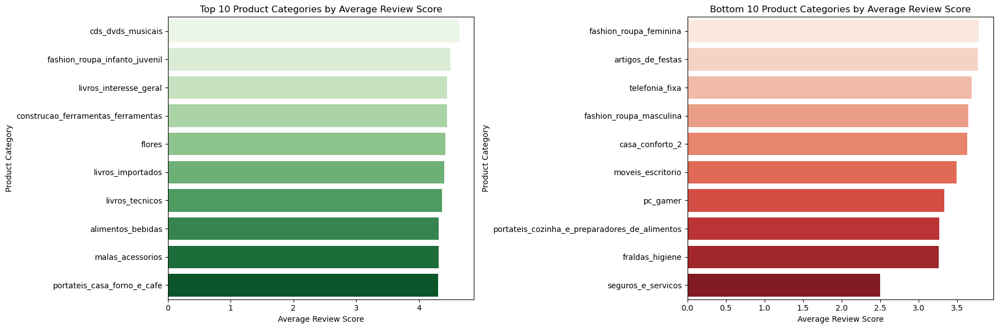

In [260]:
# Merge orders with order items
merged_df = databases['orders_df'].merge(databases['order_items_df'], on='order_id', how='left')

# Merge with products to get product category
merged_df = merged_df.merge(databases['products_df'][['product_id', 'product_category_name']], on='product_id', how='left')

# Merge with reviews to get review scores
merged_df = merged_df.merge(databases['reviews_df'][['order_id', 'review_score']], on='order_id', how='left')

# Calculate average review score per product category
avg_review_per_category = merged_df.groupby('product_category_name')['review_score'].mean().sort_values(ascending=False)

# Top 10 highest rated categories
top_10_categories_by_review = avg_review_per_category.head(10)

# Bottom 10 lowest rated categories
bottom_10_categories_by_review = avg_review_per_category.tail(10)

# Plot
fig, axes = plt.subplots(1, 2, figsize=(18, 6))

sns.barplot(x=top_10_categories_by_review.values, y=top_10_categories_by_review.index, palette="Greens", ax=axes[0])
axes[0].set_title("Top 10 Product Categories by Average Review Score")
axes[0].set_xlabel("Average Review Score")
axes[0].set_ylabel("Product Category")

sns.barplot(x=bottom_10_categories_by_review.values, y=bottom_10_categories_by_review.index, palette="Reds", ax=axes[1])
axes[1].set_title("Bottom 10 Product Categories by Average Review Score")
axes[1].set_xlabel("Average Review Score")
axes[1].set_ylabel("Product Category")

plt.tight_layout()
plt.show()


C:\Users\User\AppData\Local\Temp\ipykernel_27612\548480759.py:17: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='bad_review', y='delivery_time', data=merged_df, palette="coolwarm")


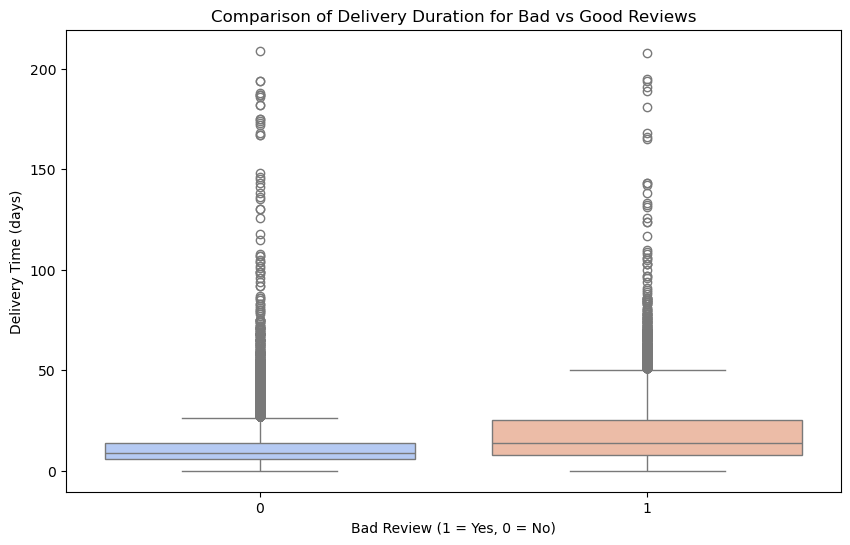

Average delivery time for bad reviews: 18.26 days
Average delivery time for good reviews: 10.94 days


In [264]:
# Merge all needed tables
merged_df = databases['orders_df'].merge(databases['order_items_df'], on='order_id', how='left')
merged_df = merged_df.merge(databases['products_df'][['product_id', 'product_category_name']], on='product_id', how='left')
merged_df = merged_df.merge(databases['reviews_df'][['order_id', 'review_score']], on='order_id', how='left')
# Make sure timestamps are in datetime format
merged_df['order_purchase_timestamp'] = pd.to_datetime(merged_df['order_purchase_timestamp'])
merged_df['order_delivered_customer_date'] = pd.to_datetime(merged_df['order_delivered_customer_date'])

# Create delivery time column (in days)
merged_df['delivery_time'] = (merged_df['order_delivered_customer_date'] - merged_df['order_purchase_timestamp']).dt.days

# Define bad reviews as scores 1 or 2
merged_df['bad_review'] = merged_df['review_score'].apply(lambda x: 1 if x <= 2 else 0)

# Boxplot comparing delivery time by review type
plt.figure(figsize=(10, 6))
sns.boxplot(x='bad_review', y='delivery_time', data=merged_df, palette="coolwarm")
plt.title("Comparison of Delivery Duration for Bad vs Good Reviews")
plt.xlabel("Bad Review (1 = Yes, 0 = No)")
plt.ylabel("Delivery Time (days)")
plt.show()

# Calculate average delivery time for each group
avg_delivery_bad_review = merged_df[merged_df['bad_review'] == 1]['delivery_time'].mean()
avg_delivery_good_review = merged_df[merged_df['bad_review'] == 0]['delivery_time'].mean()

print(f"Average delivery time for bad reviews: {avg_delivery_bad_review:.2f} days")
print(f"Average delivery time for good reviews: {avg_delivery_good_review:.2f} days")

In [256]:
from folium.plugins import HeatMap

# Sample if needed to reduce lag
heatmap_data = geolocation_df[['geolocation_lat', 'geolocation_lng']].dropna().sample(n=5000, random_state=42)

# Create a map
m = folium.Map(location=[-14.2350, -51.9253], zoom_start=4)

# Add heatmap
HeatMap(data=heatmap_data.values).add_to(m)

# Show map
m


In [21]:
import folium
from folium.plugins import HeatMap

# Sample for better performance
heatmap_data = geolocation_df[['geolocation_lat', 'geolocation_lng']].dropna().sample(n=5000, random_state=42)

# Create a map
m = folium.Map(location=[-14.2350, -51.9253], zoom_start=4)

# Add heatmap
HeatMap(data=heatmap_data.values, min_opacity=0.2, max_val=1.0).add_to(m)

# Add Legend
m.get_root().html.add_child(folium.Element("""
    <div style="position: fixed; bottom: 50px; left: 50px; width: 200px; height: 150px; background-color: rgba(255, 255, 255, 0.7); padding: 10px;">
        <h5>Heatmap Legend</h5>
        <p><strong>Low Density:</strong> <span style="color: lightblue;">&#x25A0;</span></p>
        <p><strong>High Density:</strong> <span style="color: red;">&#x25A0;</span></p>
    </div>
"""))

# Show map
m


C:\temp\ipykernel_19696\1454033463.py:11: UserWarning: The `max_val` parameter is no longer necessary. The largest intensity is calculated automatically.
  HeatMap(data=heatmap_data.values, min_opacity=0.2, max_val=1.0).add_to(m)


# Predicting Review Score (Classification)

In [267]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.preprocessing import LabelEncoder

# Merge necessary datasets (already done before)
df = databases['orders_df'].merge(databases['order_items_df'], on='order_id', how='left')
df = df.merge(databases['products_df'][['product_id', 'product_category_name']], on='product_id', how='left')
df = df.merge(databases['reviews_df'][['order_id', 'review_score']], on='order_id', how='left')

# Calculate delivery time
df['order_purchase_timestamp'] = pd.to_datetime(df['order_purchase_timestamp'])
df['order_delivered_customer_date'] = pd.to_datetime(df['order_delivered_customer_date'])
df['delivery_time'] = (df['order_delivered_customer_date'] - df['order_purchase_timestamp']).dt.days

# Drop NaNs
df = df.dropna(subset=['delivery_time', 'price', 'freight_value', 'review_score'])

# Filter only clear good/bad reviews
df = df[df['review_score'].isin([1, 2, 4, 5])]
df['label'] = df['review_score'].apply(lambda x: 1 if x >= 4 else 0)  # 1 = good, 0 = bad

In [269]:
# Encode categorical variable
le = LabelEncoder()
df['product_category_encoded'] = le.fit_transform(df['product_category_name'].astype(str))

# Select features
features = ['price', 'freight_value', 'delivery_time', 'product_category_encoded']
X = df[features]
y = df['label']

In [271]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

model = RandomForestClassifier(random_state=42)
model.fit(X_train, y_train)
# Predictions
y_pred = model.predict(X_test)
print(classification_report(y_test, y_pred))
print(confusion_matrix(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.70      0.44      0.54      3222
           1       0.90      0.96      0.93     16932

    accuracy                           0.88     20154
   macro avg       0.80      0.70      0.74     20154
weighted avg       0.87      0.88      0.87     20154

[[ 1432  1790]
 [  604 16328]]


Mean Absolute Error: 2865488.203143201


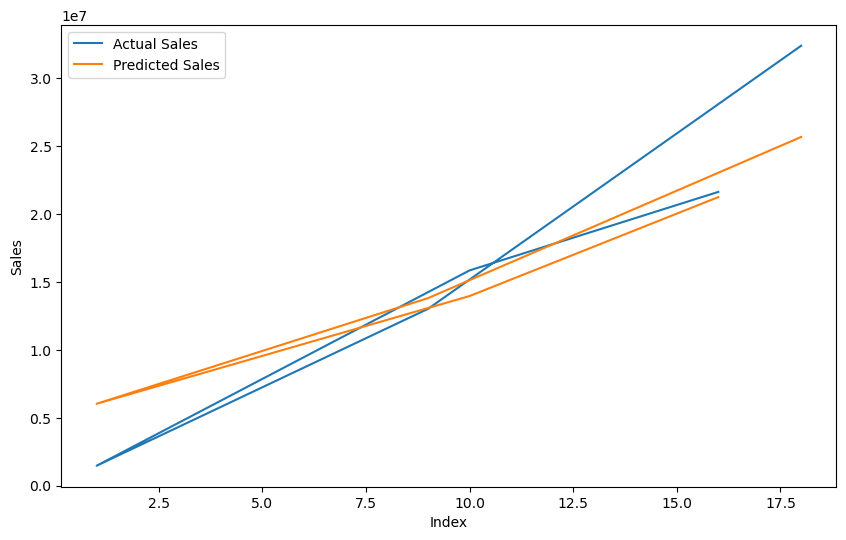

Predicted Sales for May 2025: 8942361.113602998


In [275]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error
from sqlalchemy import create_engine

# Load data
orders_df = pd.read_sql('SELECT * FROM orders', con=engine)
order_items_df = pd.read_sql('SELECT * FROM order_items', con=engine)

# Data Preprocessing
order_items_df['total_price'] = order_items_df['price'] * order_items_df['freight_value']
sales_df = pd.merge(order_items_df, orders_df[['order_id', 'order_purchase_timestamp']], on='order_id')

# Convert purchase timestamp to datetime format
sales_df['order_purchase_timestamp'] = pd.to_datetime(sales_df['order_purchase_timestamp'])

# Extract features from the purchase date (year, month, day, day of the week)
sales_df['year'] = sales_df['order_purchase_timestamp'].dt.year
sales_df['month'] = sales_df['order_purchase_timestamp'].dt.month
sales_df['day'] = sales_df['order_purchase_timestamp'].dt.day
sales_df['day_of_week'] = sales_df['order_purchase_timestamp'].dt.dayofweek

# Aggregate the total sales per month
monthly_sales = sales_df.groupby(['year', 'month'])['total_price'].sum().reset_index()

# Create lag feature for the previous month's sales
monthly_sales['sales_lag_1'] = monthly_sales['total_price'].shift(1)

# Drop NaN values (this will drop the first row)
monthly_sales = monthly_sales.dropna()

# Define features (X) and target (y)
X = monthly_sales[['year', 'month', 'sales_lag_1']]
y = monthly_sales['total_price']

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize and train the model
model = RandomForestRegressor(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Make predictions and evaluate the model
y_pred = model.predict(X_test)
mae = mean_absolute_error(y_test, y_pred)
print(f'Mean Absolute Error: {mae}')

# Plot predictions vs actual sales
plt.figure(figsize=(10, 6))
plt.plot(y_test.index, y_test, label='Actual Sales')
plt.plot(y_test.index, y_pred, label='Predicted Sales')
plt.xlabel('Index')
plt.ylabel('Sales')
plt.legend()
plt.show()

#  Predict sales for a future month 
future_data = pd.DataFrame({
    'year': [2025],
    'month': [5],
    'sales_lag_1': [monthly_sales['total_price'].iloc[-1]]  # Using last month's total sales as lag
})

# Predict sales for May 2025
predicted_sales = model.predict(future_data)
print(f'Predicted Sales for May 2025: {predicted_sales[0]}')

# Sentiment Analysis of Reviews with Translation and NLP Techniques:

In [277]:
pip install googletrans==4.0.0-rc1

  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
   ---------------------------------------- 0.0/55.1 kB ? eta -:--:--
   ---------------------------------------- 0.0/55.1 kB ? eta -:--:--
   ---------------------------------------- 0.0/55.1 kB ? eta -:--:--
   ---------------------------------------- 0.0/55.1 kB ? eta -:--:--
   ---------------------------------------- 0.0/55.1 kB ? eta -:--:--
   ---------------------------------------- 0.0/55.1 kB ? eta -:--:--
   ---------------------------------------- 0.0/55.1 kB ? eta -:--:--
   ---------------------------------------- 0.0/55.1 kB ? eta -:--:--
   ------- -------------------------------- 10.2/55.1 kB ? eta -:--:--
   ------- -------------------------------- 10.2/55.1 kB ? eta -:--:--
   ------- -------------------------------- 10.2/55.1 kB ? eta -:--:--
   ------- -------------------------------- 10.2/55.1 kB ? eta -:--:--
   ------- -------------------------------- 10.2/55.1 

In [283]:
pip install nltk

Note: you may need to restart the kernel to use updated packages.


## SentimentIntensityAnalyzer:

The VADER SentimentIntensityAnalyzer from the nltk library gives a sentiment score for the text. It returns a dictionary of scores for negative, neutral, positive, and a "compound" score.

The compound score is the most useful, as it’s a normalized score between -1 and 1, where:

- A positive score indicates positive sentiment.

- A negative score indicates negative sentiment.

- A score close to zero indicates neutral sentiment.

Sentiment Classification:

We classify the sentiment based on the compound score:

- Positive: If the score is greater than or equal to 0.05.

- Negative: If the score is less than or equal to -0.05.

- Neutral: If the score is between -0.05 and 0.05.

Storing Sentiment:

We store the sentiment label (Positive, Negative, Neutral) in a new column review_sentiment.

In [298]:
pip install deep-translator

   ---------------------------------------- 0.0/42.3 kB ? eta -:--:--
   ------------------- -------------------- 20.5/42.3 kB 640.0 kB/s eta 0:00:01
   ---------------------------------------- 42.3/42.3 kB 410.8 kB/s eta 0:00:00
Note: you may need to restart the kernel to use updated packages.


In [ ]:
from deep_translator import GoogleTranslator
from nltk.sentiment import SentimentIntensityAnalyzer
import nltk

# Download VADER lexicon if not already installed
nltk.download('vader_lexicon')

# Function to translate text from Portuguese to English
def translate_to_english(text):
    if not text:  # Check if the text is None or empty
        return ""  # Return empty string if text is missing
    try:
        # Translate the review text using deep-translator
        translated = GoogleTranslator(source='pt', target='en').translate(text)
        return translated
    except Exception as e:
        print(f"Error translating text: {e}")
        return text  # Return the original text in case of an error

# Sentiment Analysis Function using VADER
def get_sentiment(text):
    # Initialize VADER sentiment intensity analyzer
    sia = SentimentIntensityAnalyzer()
    
    # Get the polarity scores
    sentiment_scores = sia.polarity_scores(text)
    
    # Return the compound score (a normalized score between -1 and 1)
    return sentiment_scores['compound']

# Categorize sentiment as Positive, Neutral, or Negative
def categorize_sentiment(score):
    if score >= 0.05:
        return 'Positive'
    elif score <= -0.05:
        return 'Negative'
    else:
        return 'Neutral'

# Load reviews data from the database into a DataFrame
with engine.connect() as conn:
    reviews_df = pd.read_sql('SELECT review_id, review_comment_message FROM reviews', conn)

# Translate the reviews to English
reviews_df['translated_review'] = reviews_df['review_comment_message'].apply(translate_to_english)

# Perform sentiment analysis on the translated reviews
reviews_df['sentiment_score'] = reviews_df['translated_review'].apply(get_sentiment)

# Categorize sentiment based on sentiment score
reviews_df['sentiment_label'] = reviews_df['sentiment_score'].apply(categorize_sentiment)

# Display the first 10 rows with sentiment analysis results
print(reviews_df[['review_id', 'review_comment_message', 'translated_review', 'sentiment_score', 'sentiment_label']].head(10))

# save the updated reviews back to the database 
with engine.connect() as conn:
    reviews_df[['review_id', 'sentiment_score', 'sentiment_label']].to_sql('reviews_sentiment', con=engine, if_exists='replace', index=False)

print("Sentiment analysis completed and results saved.")

[nltk_data] Downloading package vader_lexicon to
[nltk_data]     C:\Users\User\AppData\Roaming\nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!
